# Computational Project: Lenia

In [1]:
#import useful libraries
import numpy as np
import matplotlib.pylab as plt
import matplotlib.cm as cm
import matplotlib.animation
import IPython.display
import scipy.signal
import warnings

warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)
warnings.filterwarnings('ignore', category=matplotlib.MatplotlibDeprecationWarning)


#set default parameters
size = 64 #size of grid
R = 1 #kernel radius


#define function to display system as grid
#array A is the world

def display(A, cmap='PuRd', scale=False):
    '''returns figure containing array, A, represented as a grid
        with specified colour map and colour scale'''
    
    global img
    
    fig = plt.figure() #figure serves as a container for the plot
    img = plt.imshow(A, cmap=cmap, interpolation="nearest", vmin=0, vmax=1)
    
    plt.title('System')

    if scale:
        #display colour scale when continuous states not just binary
        cbar = plt.colorbar(img)
        cbar.set_label('Cell status')
        cbar.set_ticks([0, 1])
        cbar.set_ticklabels(['Dead', 'Live'])
    
    plt.close()
    
    return fig

In [2]:
'''structures of discovered cretures in Lenia
Orbium loaded from Bert Chan's code'''


pattern = {}

pattern["orbium"] = {"name":"Orbium","R":13,"T":10,"m":0.15,"s":0.015,"b":[1],
  "cells":[[0,0,0,0,0,0,0.1,0.14,0.1,0,0,0.03,0.03,0,0,0.3,0,0,0,0], [0,0,0,0,0,0.08,0.24,0.3,0.3,0.18,0.14,0.15,0.16,0.15,0.09,0.2,0,0,0,0], [0,0,0,0,0,0.15,0.34,0.44,0.46,0.38,0.18,0.14,0.11,0.13,0.19,0.18,0.45,0,0,0], [0,0,0,0,0.06,0.13,0.39,0.5,0.5,0.37,0.06,0,0,0,0.02,0.16,0.68,0,0,0], [0,0,0,0.11,0.17,0.17,0.33,0.4,0.38,0.28,0.14,0,0,0,0,0,0.18,0.42,0,0], [0,0,0.09,0.18,0.13,0.06,0.08,0.26,0.32,0.32,0.27,0,0,0,0,0,0,0.82,0,0], [0.27,0,0.16,0.12,0,0,0,0.25,0.38,0.44,0.45,0.34,0,0,0,0,0,0.22,0.17,0], [0,0.07,0.2,0.02,0,0,0,0.31,0.48,0.57,0.6,0.57,0,0,0,0,0,0,0.49,0], [0,0.59,0.19,0,0,0,0,0.2,0.57,0.69,0.76,0.76,0.49,0,0,0,0,0,0.36,0], [0,0.58,0.19,0,0,0,0,0,0.67,0.83,0.9,0.92,0.87,0.12,0,0,0,0,0.22,0.07], [0,0,0.46,0,0,0,0,0,0.7,0.93,1,1,1,0.61,0,0,0,0,0.18,0.11], [0,0,0.82,0,0,0,0,0,0.47,1,1,0.98,1,0.96,0.27,0,0,0,0.19,0.1], [0,0,0.46,0,0,0,0,0,0.25,1,1,0.84,0.92,0.97,0.54,0.14,0.04,0.1,0.21,0.05], [0,0,0,0.4,0,0,0,0,0.09,0.8,1,0.82,0.8,0.85,0.63,0.31,0.18,0.19,0.2,0.01], [0,0,0,0.36,0.1,0,0,0,0.05,0.54,0.86,0.79,0.74,0.72,0.6,0.39,0.28,0.24,0.13,0], [0,0,0,0.01,0.3,0.07,0,0,0.08,0.36,0.64,0.7,0.64,0.6,0.51,0.39,0.29,0.19,0.04,0], [0,0,0,0,0.1,0.24,0.14,0.1,0.15,0.29,0.45,0.53,0.52,0.46,0.4,0.31,0.21,0.08,0,0], [0,0,0,0,0,0.08,0.21,0.21,0.22,0.29,0.36,0.39,0.37,0.33,0.26,0.18,0.09,0,0,0], [0,0,0,0,0,0,0.03,0.13,0.19,0.22,0.24,0.24,0.23,0.18,0.13,0.05,0,0,0,0], [0,0,0,0,0,0,0,0,0.02,0.06,0.08,0.09,0.07,0.05,0.01,0,0,0,0,0]]
}

pattern["geminium"] = {"name":"Hydrogeminium","R":18,"T":10,"m":0.26,"s":0.036,"b":[0.5,1,0.667],
  "cells":[[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.01,0.02,0.03,0.04,0.04,0.04,0.03,0.02,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.04,0.1,0.16,0.2,0.23,0.25,0.24,0.21,0.18,0.14,0.1,0.07,0.03,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.01,0.09,0.2,0.33,0.44,0.52,0.56,0.58,0.55,0.51,0.44,0.37,0.3,0.23,0.16,0.08,0.01,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.13,0.29,0.45,0.6,0.75,0.85,0.9,0.91,0.88,0.82,0.74,0.64,0.55,0.46,0.36,0.25,0.12,0.03,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.14,0.38,0.6,0.78,0.93,1.0,1.0,1.0,1.0,1.0,1.0,0.99,0.89,0.78,0.67,0.56,0.44,0.3,0.15,0.04,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.08,0.39,0.74,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.98,0.85,0.74,0.62,0.47,0.3,0.14,0.03,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.32,0.76,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.88,0.75,0.61,0.45,0.27,0.11,0.01,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.35,0.83,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.88,0.73,0.57,0.38,0.19,0.05,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.5,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.99,1.0,1.0,1.0,1.0,0.99,1.0,1.0,1.0,1.0,1.0,1.0,0.85,0.67,0.47,0.27,0.11,0.01], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.55,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.93,0.83,0.79,0.84,0.88,0.89,0.9,0.93,0.98,1.0,1.0,1.0,1.0,0.98,0.79,0.57,0.34,0.15,0.03], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.47,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9,0.72,0.54,0.44,0.48,0.6,0.7,0.76,0.82,0.91,0.99,1.0,1.0,1.0,1.0,0.91,0.67,0.41,0.19,0.05], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.27,0.99,1.0,1.0,1.0,1.0,0.9,0.71,0.65,0.55,0.38,0.2,0.14,0.21,0.36,0.52,0.64,0.73,0.84,0.95,1.0,1.0,1.0,1.0,1.0,0.78,0.49,0.24,0.07], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.14,0.63,0.96,1.0,1.0,1.0,0.84,0.17,0,0,0,0,0,0,0,0.13,0.35,0.51,0.64,0.77,0.91,0.99,1.0,1.0,1.0,1.0,0.88,0.58,0.29,0.09], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.07,0.38,0.72,0.95,1.0,1.0,1.0,0.22,0,0,0,0,0,0,0,0,0,0.11,0.33,0.5,0.67,0.86,0.99,1.0,1.0,1.0,1.0,0.95,0.64,0.33,0.1], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.32,0.49,0.71,0.93,1.0,1.0,1.0,0.56,0,0,0,0,0,0,0,0,0,0,0,0.1,0.31,0.52,0.79,0.98,1.0,1.0,1.0,1.0,0.98,0.67,0.35,0.11], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.01,0.6,0.83,0.98,1.0,1.0,0.68,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.15,0.38,0.71,0.97,1.0,1.0,1.0,1.0,0.97,0.67,0.35,0.11], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.51,0.96,1.0,1.0,0.18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.09,0.34,0.68,0.95,1.0,1.0,1.0,1.0,0.91,0.61,0.32,0.1], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.13,0.56,0.99,1.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.17,0.45,0.76,0.96,1.0,1.0,1.0,1.0,0.82,0.52,0.26,0.07], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.33,0.7,0.94,1.0,1.0,0.44,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.33,0.68,0.91,0.99,1.0,1.0,1.0,1.0,0.71,0.42,0.19,0.03], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.53,0.89,1.0,1.0,1.0,0.8,0.43,0.04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.47,0.86,1.0,1.0,1.0,1.0,1.0,0.95,0.58,0.32,0.12,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.77,0.99,1.0,0.97,0.58,0.41,0.33,0.18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.54,0.95,1.0,1.0,1.0,1.0,1.0,0.8,0.44,0.21,0.06,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.39,0.83,1.0,1.0,0.55,0.11,0.05,0.15,0.22,0.06,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.58,0.99,1.0,1.0,1.0,1.0,1.0,0.59,0.29,0.11,0.01,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.04,0.55,0.81,0.86,0.97,1.0,1.0,0.5,0,0,0.01,0.09,0.03,0,0,0,0,0,0,0,0,0,0,0,0,0,0.26,0.78,1.0,1.0,1.0,1.0,1.0,0.66,0.35,0.13,0.03,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.33,1.0,1.0,1.0,1.0,1.0,1.0,0.93,0.11,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.23,0.73,0.95,1.0,1.0,1.0,1.0,1.0,0.62,0.35,0.12,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.51,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.72,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.56,0.25,0.09,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.12,0.38,1.0,1.0,1.0,0.66,0.08,0.55,1.0,1.0,1.0,0.03,0,0,0,0,0,0,0,0,0,0,0,0,0,0.35,1.0,1.0,1.0,1.0,1.0,1.0,0.67,0.12,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0.6,1.0,1.0,1.0,1.0,1.0,1.0,0.49,0,0,0.87,1.0,0.88,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,1.0,1.0,1.0,1.0,1.0,0.7,0.07,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0.04,0.21,0.48,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,0,0.04,0.42,0.26,0,0,0,0,0,0,0,0,0,0.12,0.21,0.34,0.58,1.0,1.0,1.0,0.99,0.97,0.99,0.46,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0.5,1.0,1.0,1.0,1.0,0.96,0,0.31,1.0,1.0,1.0,0.53,0,0,0,0,0,0,0,0,0.2,0.21,0,0,0,0.27,1.0,1.0,1.0,1.0,1.0,1.0,0.87,0.52,0.01,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0.84,1.0,1.0,1.0,1.0,1.0,0,0,0,0.83,1.0,1.0,0.52,0,0,0,0,0,0,0,0.26,0.82,0.59,0.02,0,0,0.46,1.0,1.0,1.0,1.0,1.0,0.9,0.55,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0.39,0.99,1.0,1.0,1.0,1.0,0.78,0.04,0,0,0,0.93,0.92,0,0,0,0,0,0,0,0,0.69,1.0,1.0,0.36,0,0,1.0,1.0,0.65,0.66,0.97,0.87,0.54,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.55,0.75,0.59,0.74,1.0,1.0,0,0,0.75,0.71,0.18,0,0,0,0,0,0,0,0,0,0,0.29,0,0,0.45,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.47,0.39,0.71,0.25,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.69,0.81,0.8,0.92,1.0,0.13,0,0,0.13,0.94,0.58,0,0,0,0,0,0,0,0,0,1.0,1.0,0.34,0,0.04,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.24,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.63,0.85,0.9,0.98,1.0,0.09,0,0,0.02,1.0,0.64,0,0,0,0,0,0,0,0,0.59,1.0,1.0,0.84,0,0,1.0,1.0,1.0,1.0,1.0,1.0,0.64,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.64,0.65,0.67,1.0,1.0,0.21,0.01,0,0.04,0.02,0,0,0,0,0,0,0,0,0,0.69,1.0,1.0,1.0,0.29,0.37,1.0,1.0,0.6,0.63,1.0,0.84,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.44,0.73,0.73,0.85,1.0,0.97,0.23,0.05,0,0,0,0,0,0,0,0,0.06,0,0,0,0.97,1.0,1.0,1.0,1.0,1.0,1.0,0.33,0.24,0.67,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0.12,0.55,0.9,0.9,1.0,1.0,1.0,0.43,0.04,0,0,0,0,0,0,0,0.31,0.54,0,0,0,0.88,1.0,1.0,1.0,1.0,1.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0.29,0.71,1.0,1.0,1.0,1.0,0.79,0.28,0,0,0,0,0,0,0,0,0.4,0.77,0.54,0,0,0.87,1.0,1.0,1.0,1.0,1.0,0.31,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0.16,0.27,0.41,0.72,0.99,1.0,1.0,0.82,0.42,0.09,0,0,0,0,0,0,0,0,0.1,0.55,0.58,0.58,0.77,0.99,1.0,1.0,1.0,1.0,0.63,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0.31,0.48,0.45,0.46,0.63,0.88,1.0,0.83,0.59,0.28,0.06,0,0,0,0,0,0,0,0,0,0.32,0.7,0.95,1.0,1.0,1.0,1.0,0.7,0.58,0.12,0.04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0.23,0.54,0.53,0.48,0.57,0.59,0.65,0.63,0.55,0.35,0.13,0.03,0.02,0.09,0.74,1.0,0.09,0,0,0,0.32,0.86,1.0,1.0,1.0,1.0,0.57,0.44,0.31,0.16,0.01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0.31,0.45,0.31,0.18,0.28,0.39,0.47,0.54,0.5,0.35,0.2,0.16,0.28,0.75,1.0,0.42,0.01,0,0,0.6,1.0,1.0,1.0,1.0,0.51,0.29,0.09,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0.14,0.3,0.4,0.54,0.71,0.74,0.65,0.49,0.35,0.27,0.47,0.6,0.6,0.72,0.98,1.0,1.0,1.0,1.0,0.65,0.33,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0.06,0.33,0.53,0.69,0.94,0.99,1.0,0.84,0.41,0.16,0.15,0.96,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.73,0.13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0.42,0.86,0.98,0.98,0.99,1.0,0.94,0.63,0.32,0.62,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.65,0.23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0.07,0.62,0.95,1.0,1.0,0.99,0.98,0.99,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.98,0.14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0.03,0.46,0.89,1.0,1.0,0.97,0.83,0.75,0.81,0.94,1.0,1.0,1.0,1.0,0.99,0.03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0.14,0.57,0.88,0.93,0.81,0.58,0.45,0.48,0.64,0.86,0.97,0.99,0.99,0.42,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0.23,0.45,0.47,0.39,0.29,0.19,0.2,0.46,0.28,0.03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0.08,0.22,0.24,0.15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0.07,0.22,0.14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]]
}

pattern["blinker"] = {
  "name": "Blinker",
  "R": 1,
  "cells": [
    [0,1,1,1,0],
    [0,0,0,0,1],
    [0,0,0,0,1],
    [0,0,0,0,1],
    [0,1,1,1,0]
  ]
}

# Conway's game of life

2D discrete cellular automata. Basic implementation on finite grid based on the code by Jake VanderPlas

### Rules:

Underpopulation: any live cell with fewer than two live neighbours dies

Stasis: any live cell with two or three live neighbours lives on to the next generation

Overpopulation: any live cell with more than three live neighbours dies

Reproduction: any dead cell with exactly three live neighbours becomes a live cell

In [3]:
'''Create the world
numpy generates random numbers in a deterministic way
by setting a seed, we will always start with the same random set''' 
np.random.seed(0)
#generate random integers either 0 or 1 to fill a matrix of size x size
A = np.random.randint(2,size=(size,size))

def update_gol(i):
    '''advances the world by one time step
    applies to every element in the array
    counts the number of Moore neighbours
    uses the growth rule to determine the state in next time step'''
    
    #call the world grid
    global A

    '''U is the neighbour sums
    counts 8 nearest Moore neigbours - if statement excludes counting cell itself
    np roll deals with periodic boundary conditions, equivalent to toroidal arrangement of 2D space'''
    
    U = sum(np.roll(A,(i,j),axis=(0,1)) for i in (-1,0,+1) for j in (-1,0,+1) if (i!=0 or j!=0))

    '''update cell value according to rules
    if cell is alive and U = 2, the cell continues alive (value 1)
    if cell is dead or alive and U = 3, the cell lives (value 1)
    all other cases cell dies (value 0)'''
    
    A = (A & (U==2)) | (U==3)
    
    img.set_array(A) #visual representation of array
    return img

#initiate the visual representation and animation 
fig = display(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig,update_gol,frames=50,interval=50).to_jshtml())

In [4]:
size=64
R=1

scale = 1.5;  cx, cy = 25, 25
globals().update(pattern["blinker"]); C = np.asarray(cells)
A = np.zeros([size, size])
C = scipy.ndimage.zoom(C, scale, order=0);  R *= scale
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C
A = A.astype(int)


#initiate the visual representation and animation 
fig = display(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig,update_gol,frames=60,interval=50).to_jshtml())


#save animation as gif
#ani = matplotlib.animation.FuncAnimation(fig, update, frames=60, interval=50)
#ani.save('gol.gif', writer='pillow')

# Lenia

A continuous generalisation of Conway's Game of Life. Space-states-time made continuous.

This is based on Bert Chan's code with modifications and definition of a kernel class for easier analysis.

In [5]:
''' define kernel and use convolution with kernel instead of counting neighbours
make the Kernel into a class to define different instances
e.g. circular, square etc'''

#define gaussian curve function - used to make smooth kernels with gradual fade
bell = lambda x, mean, std: np.exp(-((x-mean)/std)**2 / 2)
convolution_FFT = False #start by using scipy function to calculate the convolution

class Kernel:
    '''define normalised convolution kernel
    allows generalisation rather than counting neighbours'''

    global bell
    
    def __init__(self, size, kernel_type='square', smooth=False, R=None, end=False):
        
        if kernel_type == 'square':
            #create a square kernel
            self.K = np.ones((2*R+1, 2*R+1))
            self.K[R, R] = 0  # centre pixel
            self.K_sum = np.sum(self.K)  # maximum value of the convolution
            self.K = self.K / self.K_sum  # normalise the kernel
            if end: #make kernel same size as world grid
                pad = (size - (2*R+1)) //2
                if size%2 == 0:
                    self.K = np.pad(self.K, ((pad, pad+1), (pad, pad+1)), mode='constant')
                else:
                    self.K = np.pad(self.K, ((pad, pad), (pad, pad)), mode='constant')
            
        elif kernel_type == 'circular':
            #create a circular kernel
            if end: 
                #kernel same size as world grid
                mid = size//2
                x = np.arange(-mid, mid)
                y = np.arange(-mid, mid)
            else:
                x = np.arange(-R,R+1)
                y = np.arange(-R,R+1)

            X, Y = np.meshgrid(x, y)
            center = np.array([0,0])

            #check if distance from centre is less than specified radius
            distance = np.linalg.norm(np.stack((X,Y),axis=-1)-center,axis=-1)/R

            #give value to 
            if smooth:
                self.K = (distance<=1.0) * bell(distance,0.5,0.15)
            else:
                self.K = (distance<=1.0)
                self.K[R, R] = 0  # centre pixel
                
            
            self.K_sum = np.sum(self.K)  # maximum value of the convolution
            self.K = self.K / self.K_sum  # normalise the kernel

    def growth(self, U, m=0.15, s=0.015):
        '''define the growth function'''
        
        '''tophat:
        condition_alive = (U >= 0.12) & (U <= 0.15)
        condition_dead = (U < 0.12) | (U > 0.15)
        return np.where(condition_alive, 1, np.where(condition_dead, -1, 0))'''
        
        '''continuous'''
        return bell(U, m, s)*2 - 1 #gaussian range(0,1) adjust st (-1,1)

In [6]:
#instantiate a square kernel
K_square = Kernel(size, kernel_type='square', R=5)

#instantiate a circular kernel
K_circular = Kernel(size, kernel_type='circular', R=5)

#instantiate a smoothed ring kernel
K_ring = Kernel(size, kernel_type='circular', smooth=1, R=10)

In [7]:
def plots(kernel, cmap='PuRd', bar_K=False, save=False):
    '''produces 3 subplots:
    kernel shape, kernel cross section, growth function'''
    
    global R
    
    fig, ax = plt.subplots(1, 3, figsize=(14,2), gridspec_kw={'width_ratios': [1,1,2]})

    '''kernel shape plot'''
    ax[0].imshow(kernel.K, cmap=cmap, interpolation="nearest", vmin=0)
    ax[0].title.set_text('kernel K')

    '''kernel cross-section plot'''
    K_size = kernel.K.shape[0]
    K_mid = K_size // 2
    if bar_K: #plots the crossection as a bar chart
        ax[1].bar(range(K_size), kernel.K[K_mid,:], width=1, color=cm.get_cmap(cmap)(0.95))
    else: #plots the crossection as a line graph
        ax[1].plot(range(K_size), kernel.K[K_mid,:], color=cm.get_cmap(cmap)(0.95))
    ax[1].title.set_text('K cross-section')
    ax[1].set_xlim([K_mid - R - 3, K_mid + R + 3])

    '''growth function'''
    x = np.linspace(0, np.sum(kernel.K), 1000)
    ax[2].plot(x, kernel.growth(x),color=cm.get_cmap(cmap)(0.95))
    ax[2].axhline(y=0, color='grey', linestyle='dotted')
    ax[2].title.set_text('growth G')

    '''save the figures'''
    if save:
        plt.savefig('plots.png')
    
    return fig

In [8]:
size = 64
T = 10 #update frequency
R = 5

def update(i):
    '''advances the world by one time step
    applies to every element in the array
    convolves array with the kernel
    then uses result in growth rule'''

    global A, img, kernel, convolution_FFT,fk
    
    #U is the neighbour sums
    
    if convolution_FFT:
        '''FFT to perform convolution'''
        U = np.real(np.fft.ifft2(fK * np.fft.fft2(A)))
    else:
        '''scipy convolution function
        same mode gives output same size as A
        wrap boundary gives circular boundary conditions'''
        U = scipy.signal.convolve2d(A,kernel.K,mode='same',boundary='wrap')

    '''scale down incremental updates by factor of dt=1/T
    taking T toinfinity i.e. very small time steps, is continuous time'''
    A = np.clip(A + 1/T * kernel.growth(U), 0, 1)

    img.set_array(A) #visual representation of array
    return img

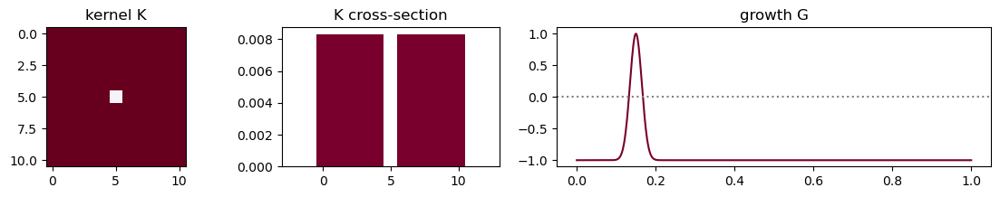

In [9]:
'''numpy generates random numbers in a deterministic way
by setting a seed, we will always start with the same random set'''
np.random.seed(0)
#generate random numbers between 0 and 1 to fill a matrix of size x size
A = np.random.rand(size,size)

kernel = K_square

#initiate the visual representation and animation 
plots(kernel, bar_K=True)

'''show animation'''
fig = display(A,scale=True)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig,update,frames=200,interval=20).to_jshtml())

#save animation as gif
#ani = matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20)
#ani.save('animation.gif', writer='pillow')

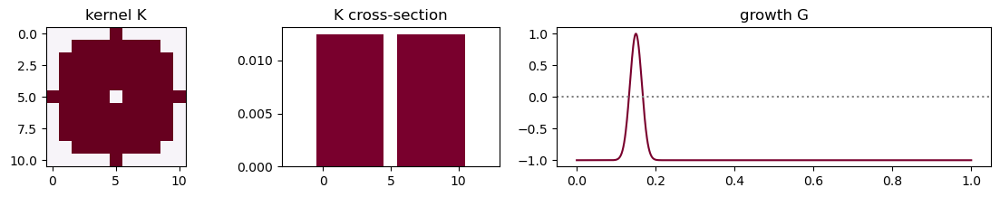

In [10]:
'''numpy generates random numbers in a deterministic way
by setting a seed, we will always start with the same random set'''
np.random.seed(0)
#generate random numbers between 0 and 1 to fill a matrix of size x size
A = np.random.rand(size,size)

kernel = K_circular

#initiate the visual representation and animation 
plots(kernel, bar_K=True)

'''show animation'''
fig = display(A,scale=True)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig,update,frames=200,interval=20).to_jshtml())

#save animation as gif
#ani = matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20)
#ani.save('animation.gif', writer='pillow')

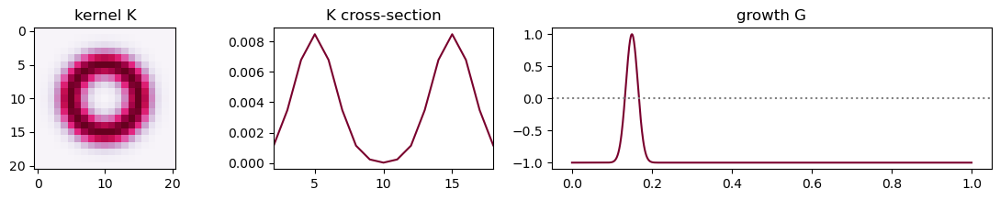

In [11]:
'''numpy generates random numbers in a deterministic way
by setting a seed, we will always start with the same random set'''
np.random.seed(0)
#generate random numbers between 0 and 1 to fill a matrix of size x size
A = np.random.rand(size,size)

kernel = K_ring

#initiate the visual representation and animation 
plots(kernel)

'''show animation'''
fig = display(A,scale=True)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig,update,frames=200,interval=20).to_jshtml())

#save animation as gif
#ani = matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20)
#ani.save('animation.gif', writer='pillow')

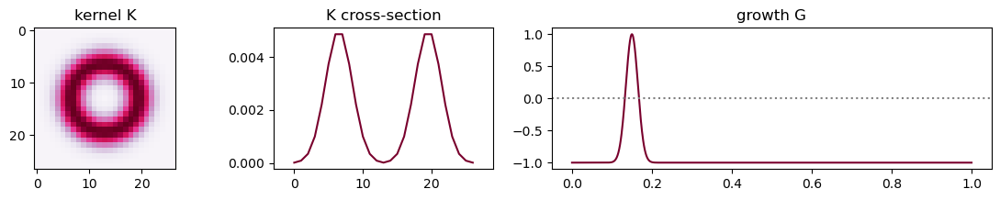

In [12]:
'''load known creature orbium and observe its behaviour'''

scale = 1;  cx, cy = 20, 20
R = 13
globals().update(pattern["orbium"]); C = np.asarray(cells)
A = np.zeros([size, size])
C = scipy.ndimage.zoom(C, scale, order=0);  R *= scale
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C

kernel = Kernel(size, kernel_type='circular', smooth=True, R=13)

plots(kernel)

'''show animation'''
fig = display(A,scale=True)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig,update,frames=200,interval=20).to_jshtml())

#save animation as gif
#ani = matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20)
#ani.save('animation.gif', writer='pillow')

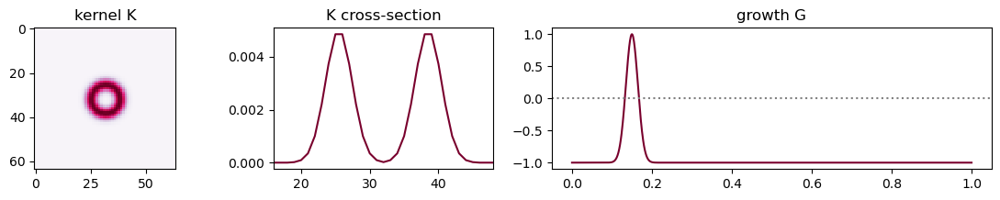

In [13]:
'''repeat the same using FFT-based convolution instead of direct convolution'''

scale = 1;  cx, cy = 20, 20
R = 13
globals().update(pattern["orbium"]); C = np.asarray(cells)
A = np.zeros([size, size])
C = scipy.ndimage.zoom(C, scale, order=0);  R *= scale
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C

#use end variable to instantiate a kernel the same size as world
kernel = Kernel(size, kernel_type='circular', smooth=True, R=13, end=True)
convolution_FFT = True #flag to use FFT
fK = np.fft.fft2(np.fft.fftshift(kernel.K / np.sum(kernel.K)))


plots(kernel,save=False)

'''show animation'''
fig = display(A,scale=True)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig,update,frames=200,interval=20).to_jshtml())


#save animation as gif
#ani = matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20)
#ani.save('animation.gif', writer='pillow')

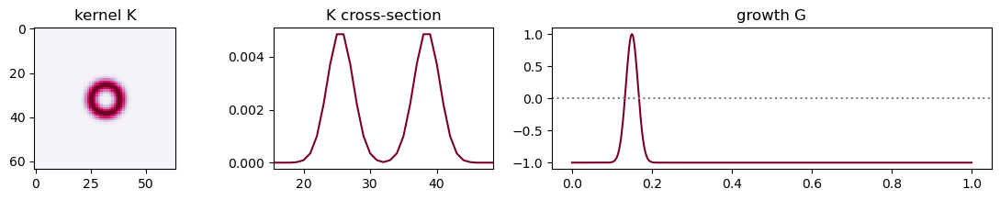

In [14]:
scale = 0.75;  cx, cy = 10, 10
globals().update(pattern["geminium"]);  b = np.asarray(b);  C = np.asarray(cells)
A = np.zeros([size, size])
C = scipy.ndimage.zoom(C, scale, order=0);  R *= scale
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C

#use end variable to instantiate a kernel the same size as world
kernel = Kernel(size, kernel_type='circular', smooth=True, R=13, end=True)
convolution_FFT = True #flag to use FFT
fK = np.fft.fft2(np.fft.fftshift(kernel.K / np.sum(kernel.K)))


plots(kernel,save=False)

'''show animation'''
fig = display(A,scale=True)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig,update,frames=200,interval=20).to_jshtml())


#save animation as gif
#ani = matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20)
#ani.save('animation.gif', writer='pillow')